# Entrega 1


In [1]:
from PIL import Image
from matplotlib import pyplot as plt
import numpy as np
import cv2

from IPython.display import display
from PIL import Image

from scipy.ndimage import gaussian_laplace
from skimage.feature import blob_log, blob_dog, blob_doh

# 1
**Implementa una ecualización adaptativa de histograma
por contraste o CLAHE, y mejora el contraste de la
imagen según sea necesario. No está permitida la
utilización de librerías que implementen dicha
transformación.**

Para el CLAHE monocolor he hecho 2 funciones. La primera es la de ecualización que aumenta el contrasete y se le puede puede pasar el clip_limit. La segunda función se encarga de dividir la imagen en tiles, aplicarle a cada uno la ecualización y luego reunificarlos.  

In [2]:
def ecualizar_histograma_con_clip(img, clip_limit=0.01):
  hist, bins = np.histogram(img.flatten(), 256, [0, 256])

  max_bins = clip_limit * img.size
  hist_clipped = np.clip(hist, 0, max_bins)  # Recortar el histograma

  # Redistribuir el exceso (diferencia) al resto de los bins
  excess = hist.sum() - hist_clipped.sum()
  hist_clipped += excess / 256

  histograma_acumulado = hist_clipped.cumsum()

  histograma_acumulado_normalizado = histograma_acumulado * 255 / np.max(histograma_acumulado)

  img_ecualizada = histograma_acumulado_normalizado[img.flatten()].reshape(img.shape)

  return img_ecualizada.astype(np.uint8)

In [3]:
def CLAHE_monoColor(img, tiles_ancho, tiles_alto, clip_limit):
  img_alto, img_ancho = img.shape[:2]

  tile_ancho = img_ancho // tiles_ancho
  tile_alto = img_alto // tiles_alto

  tiles = []

  for i in range(tiles_ancho):
    row_tiles = []
    for j in range(tiles_alto):

      esquina_sup_iz_x = i * tile_ancho
      esquina_sup_iz_y = j * tile_alto

      # Si es el último tile en el ancho o en el alto, ajustarlo para que incluya el resto de la imagen
      esquina_inferior_der_x = (i + 1) * tile_ancho if i != tiles_ancho - 1 else img_ancho
      esquina_inferior_der_y = (j + 1) * tile_alto if j != tiles_alto - 1 else img_alto

      tile = img[esquina_sup_iz_y:esquina_inferior_der_y, esquina_sup_iz_x:esquina_inferior_der_x]

      tile_ecualizada = ecualizar_histograma_con_clip(tile, clip_limit)

      row_tiles.append(tile_ecualizada)

    tiles.append(np.vstack(row_tiles))

  reconstruccion = np.hstack(tiles)
  return reconstruccion

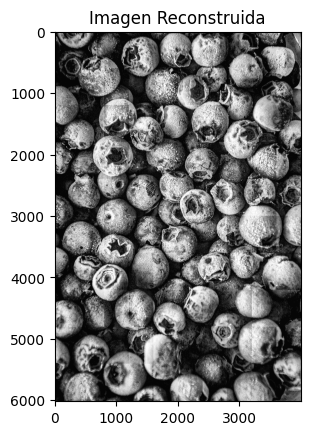

In [4]:
img = cv2.imread('1.jpg', 0)
img_ecualizada = CLAHE_monoColor(img, 10, 10, clip_limit=0.03)

plt.imshow(img_ecualizada, cmap='gray')
plt.title('Imagen Reconstruida')
plt.show()

# 2

**Utiliza el CLAHE anteriormente implementado para
modificar el contraste.**

Para este ejercicio he reutilizado la función anterior de CLAHE_moncolor. Aplicar el CLAHE por separado a los canales RGB y lugo juntarlos de nuevo no funciona y cambia mucho los colores. Por eso para el CLAHE a color he usado la escala de colores LAB. Gracias a esto aplico el CLAHE solo al canal de la L (luminosidad) y luego lo vuelvo a combinar.

In [5]:
def CLAHE_color_lab(img, tiles_ancho, tiles_alto, clip_limit):
    # Convertir la imagen a espacio de color Lab
    img_lab = cv2.cvtColor(img, cv2.COLOR_BGR2Lab)

    l_channel, a_channel, b_channel = cv2.split(img_lab)

    # Aplicar CLAHE solo al canal L
    l_channel_ecualizado = CLAHE_monoColor(l_channel, tiles_ancho, tiles_alto, clip_limit)

    # Recombinar los canales
    img_lab_ecualizada = cv2.merge((l_channel_ecualizado, a_channel, b_channel))

    img_ecualizada = cv2.cvtColor(img_lab_ecualizada, cv2.COLOR_Lab2RGB)

    return img_ecualizada

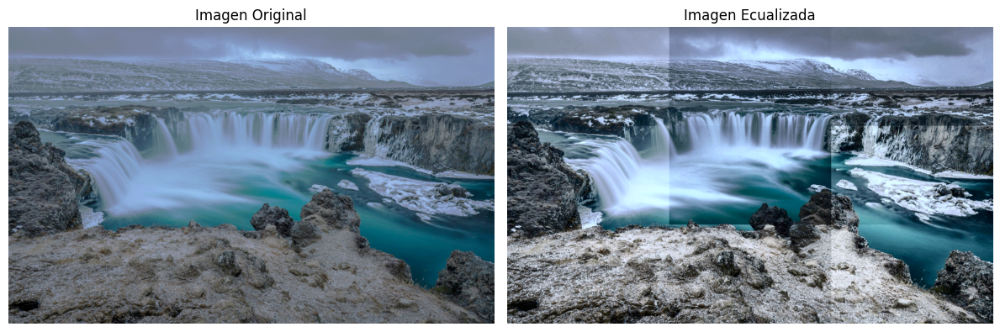

In [6]:
img_color = cv2.imread('2.jpg')

tiles_ancho = 3
tiles_alto = 3
clip_limit = 0.01
img_ecualizada = CLAHE_color_lab(img_color, tiles_ancho, tiles_alto, clip_limit)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(img_color, cv2.COLOR_BGR2RGB))
plt.title('Imagen Original')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(img_ecualizada)
plt.title('Imagen Ecualizada')
plt.axis('off')

plt.tight_layout()
plt.show()

# 3

**Elimina el ruido de la imagen.**

Este ejercicio consiste en eliminar el ruido sal y pimienta. Para eso lo mejor es usar filtros de paso bajo y no lineales. En mi caso los que han dado mejores resultados han sido el filtro de la mediana y el filtro de la mediana híbrida porque mantienen los bordes eliminando valores extremos de ruido. Estos han sido los que mejor mantienen los bordes de la hoja y sus detalles interiores.

In [7]:
from skimage import restoration, img_as_float
from skimage.io import imread, imshow
import matplotlib.pyplot as plt

array([[[253, 253, 255],
        [229, 229, 231],
        [  0,   0,   2],
        ...,
        [255, 254, 255],
        [225, 224, 230],
        [226, 225, 231]],

       [[229, 229, 231],
        [251, 251, 253],
        [228, 228, 230],
        ...,
        [226, 225, 231],
        [227, 226, 232],
        [225, 224, 230]],

       [[226, 226, 228],
        [  0,   0,   2],
        [  1,   1,   3],
        ...,
        [255, 254, 255],
        [224, 223, 228],
        [  0,   0,   4]],

       ...,

       [[225, 224, 229],
        [  0,   0,   4],
        [255, 254, 255],
        ...,
        [  0,   0,   4],
        [255, 254, 255],
        [  0,   0,   4]],

       [[  0,   0,   4],
        [  0,   0,   4],
        [225, 224, 229],
        ...,
        [221, 220, 226],
        [227, 226, 232],
        [225, 224, 230]],

       [[255, 254, 255],
        [  0,   0,   4],
        [  0,   0,   4],
        ...,
        [225, 224, 232],
        [222, 221, 229],
        [  1,   0,   8]]], dtype=uint8)
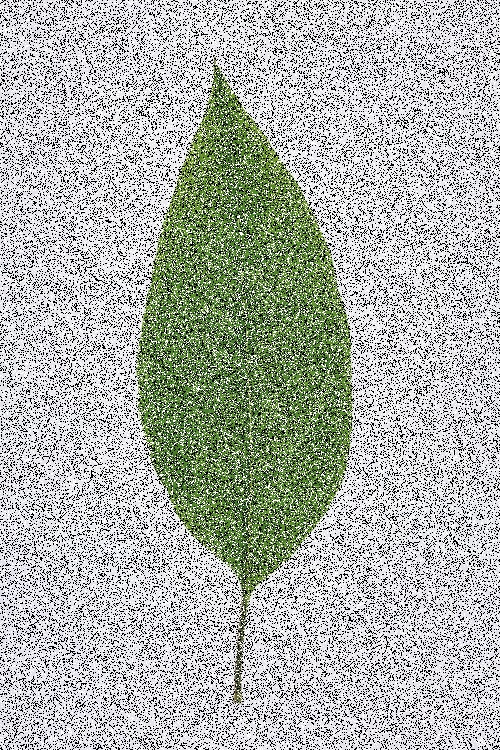

In [8]:
imagen = Image.open('3.jpg')

# imagen_alto, imagen_ancho = imagen.size
# imagen = imagen.resize((imagen_alto//2, imagen_ancho//2))

imagen_np = np.array(imagen)
imagen_np

MEDIANA

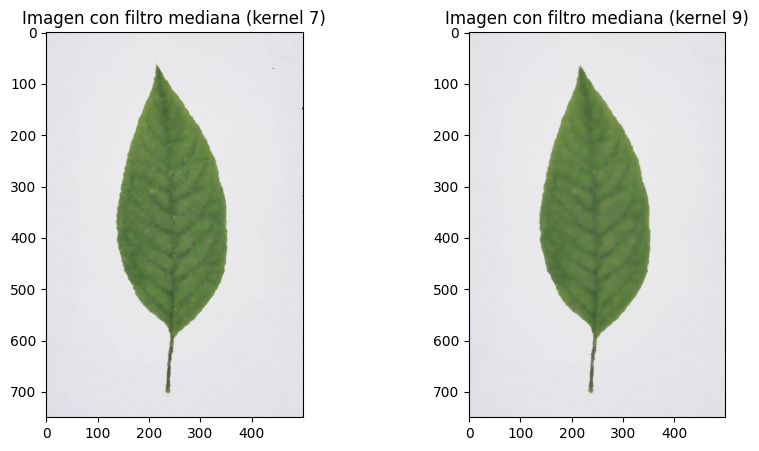

In [9]:
imagen3_sin_ruido_Mediana_7 = cv2.medianBlur(imagen_np, 7)
imagen3_sin_ruido_Mediana_9 = cv2.medianBlur(imagen_np, 9)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(imagen3_sin_ruido_Mediana_7)
plt.title('Imagen con filtro mediana (kernel 7)')

plt.subplot(1, 2, 2)
plt.imshow(imagen3_sin_ruido_Mediana_9)
plt.title('Imagen con filtro mediana (kernel 9)')

plt.show()

Mediana híbrida

In [10]:
def cross_values(block):
    # Valores de la cruz (horizontal y vertical)
    centro = block.shape[0] // 2
    return np.concatenate([block[centro, :], block[:, centro]])

def x_values(block):
    # Valores en forma de X (diagonales)
    return np.concatenate([np.diag(block), np.diag(np.fliplr(block))])

def filtro_medhib_color(image, kernel_size=5):
    # Crear una imagen de salida vacía con el mismo tamaño que la original
    img_filtrada = np.zeros(image.shape, dtype=np.int16)

    # Definir el tamaño de la ventana (mitad del kernel)
    v = int((kernel_size - 1) / 2)

    # Aplicar el padding de manera simétrica para cada canal
    padded_img = np.pad(image, ((v, v), (v, v), (0, 0)), mode='symmetric')  # Añadir padding solo en filas y columnas

    # Iterar sobre todos los píxeles de la imagen original (gracias al padding)
    for i in range(v, padded_img.shape[0] - v):
        for j in range(v, padded_img.shape[1] - v):
            for c in range(3):  # Para cada canal de color (R, G, B)

                # Extraer el área del vecindario para el canal actual
                block = padded_img[i - v:i + v + 1, j - v:j + v + 1, c]

                # Derivar los valores en forma de cruz y en forma de 'X'
                values_cross = cross_values(block)
                values_x = x_values(block)

                # Calcular las medianas
                wBcMed = np.median(values_cross)
                wBpMed = np.median(values_x)

                # Calcular la mediana híbrida del píxel original y las dos medianas extraídas
                xmed = np.median([wBcMed, wBpMed, padded_img[i, j, c]])

                # Asignar el valor al píxel filtrado
                img_filtrada[i - v, j - v, c] = int(xmed)

    return img_filtrada



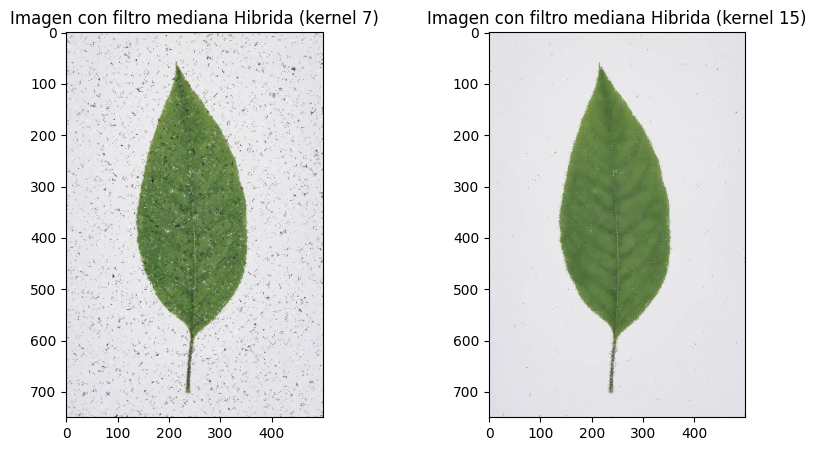

In [11]:
imagen3_sin_ruido_MedianaHib_7 = filtro_medhib_color(imagen_np, kernel_size=7)
imagen3_sin_ruido_MedianaHib_15 = filtro_medhib_color(imagen_np, kernel_size=15)


plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(imagen3_sin_ruido_MedianaHib_7)
plt.title('Imagen con filtro mediana Hibrida (kernel 7)')

plt.subplot(1, 2, 2)
plt.imshow(imagen3_sin_ruido_MedianaHib_15)
plt.title('Imagen con filtro mediana Hibrida (kernel 15)')

plt.show()


# 4
**Elimina el ruido de la imagen.**

Esta imagen tiene ruido gaussiano, por eso he utilizado el mismo tipo de filtros que antes. En este caso el "mejor" resultado obtenido ha sido con el filtro bilateral. De todos los que he probado es que ha tenido el mejor balance de ruido y definición de bordes.  

In [12]:
imagen4 = Image.open('4.png')

# imagen_alto, imagen_ancho = imagen.size
# imagen = imagen.resize((imagen_alto//2, imagen_ancho//2))

imagen_np = np.array(imagen4)
imagen_np.shape

(1010, 652, 3)

Esto es el mejor resultado que he podido obtener

sigmaColor=300 porque la catidad de color que mete el ruido gausiano
sigmaSpace=30 porque no quiero que los pixeles alejados influyan demasiado para mantener mejor los bordes

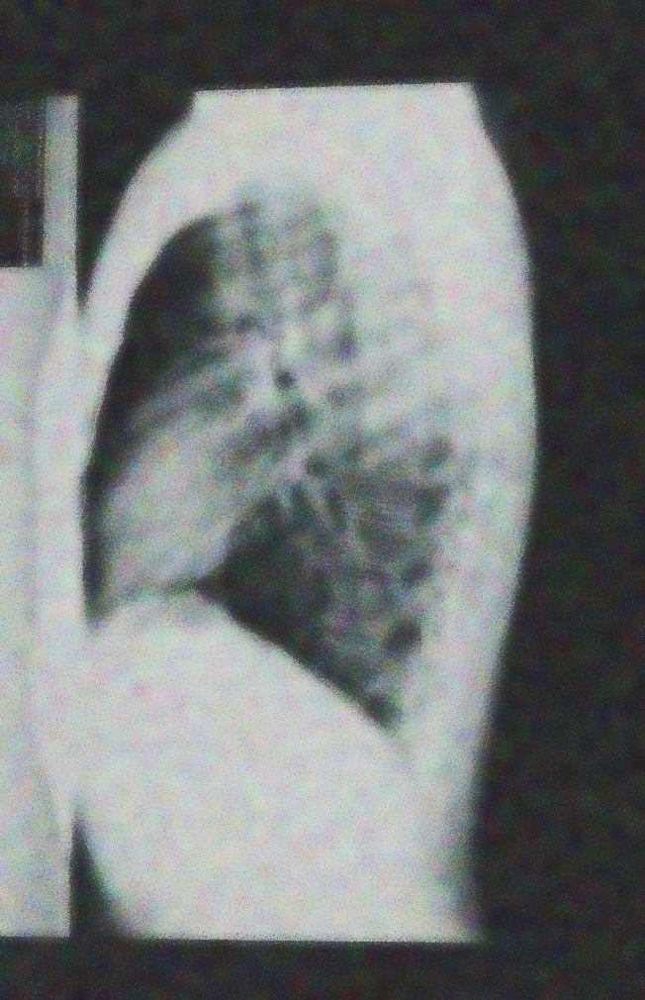

In [13]:
imagen4_sin_ruido_Bilateral = cv2.bilateralFilter(imagen_np, d=20, sigmaColor=300, sigmaSpace=30)

pil_image = Image.fromarray(imagen4_sin_ruido_Bilateral)
display(pil_image)

# 5

**Implementa un filtro gaussiano sin la utilización de
librerías y aplícalo.**

Como Un filtro gaussiano es una covolución con un kernel específico he hacho las 2 funciones por separado. La primera genera el kerner siguiendo la formula de los apuntes y la segunda es la que aplica la convolución.

In [14]:
def kernel_gaussiano(tam, sigma):
  kernel = np.zeros((tam, tam))
  centro = tam // 2
  for i in range(tam):
    for j in range(tam):
      x = i - centro
      y = j - centro
      kernel[i, j] = (1 / (2 * np.pi * sigma**2)) * (np.exp(-(x**2 +y**2)/ (2 * sigma**2)))

  kernel /= kernel.sum()
  return kernel

In [15]:
def convolucion(imagen, kernel, steps=1):
  img_alto, img_ancho = imagen.shape[:2]
  kernel_alto, kernel_ancho = kernel.shape
  pad_alto, pad_ancho = kernel_alto // 2, kernel_ancho // 2

  imagen_conv = np.zeros_like(imagen)
  imagen_padded = np.pad(imagen, ((pad_alto, pad_alto), (pad_ancho, pad_ancho), (0, 0)), mode='constant', constant_values=0)

  for i in range(img_alto):
    for j in range(img_ancho):
      # Se hace para que canal ( en este caso no altera el color )
      for c in range(3):
        region = imagen_padded[i:i + kernel_alto, j:j + kernel_ancho, c]

        if region.shape == kernel.shape:
            imagen_conv[i, j, c] = np.sum(region * kernel)
        else:
            print(f"Región fuera de rango en i={i}, j={j}")

  return imagen_conv


In [16]:
img5 = Image.open("5.jpg")
imagen_np = np.array(img5)

In [17]:
tam = 31
sigma = 5.0
kernel = kernel_gaussiano(tam, sigma)

imagen_filtrada_gauss = convolucion(imagen_np, kernel)

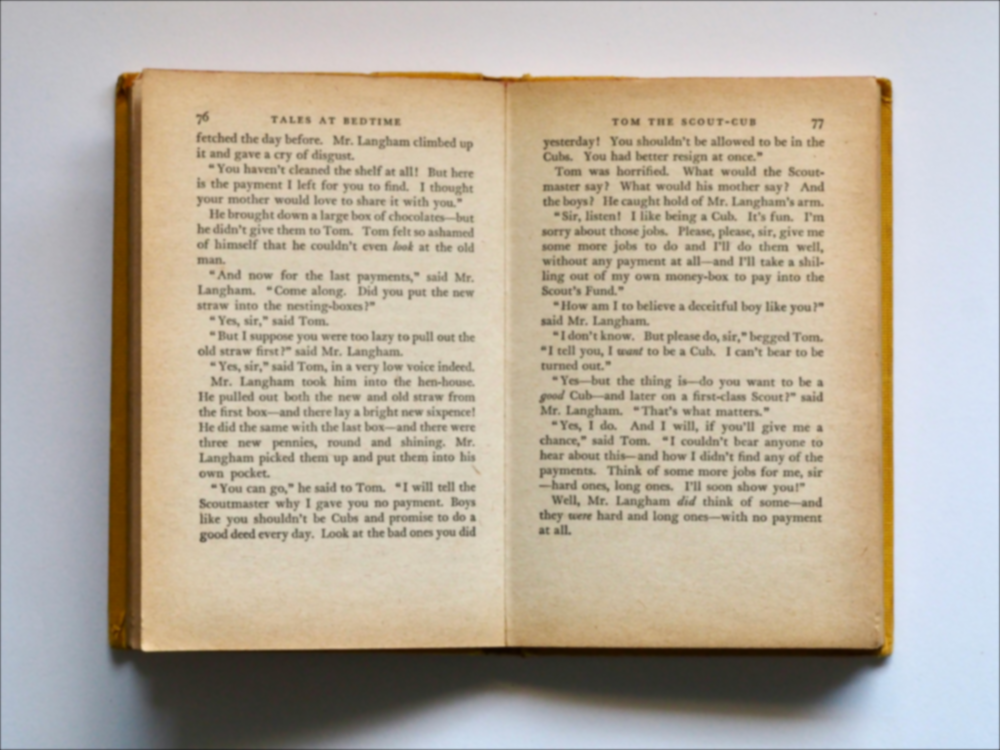

In [18]:
pil_image = Image.fromarray(imagen_filtrada_gauss)
display(pil_image)

# 6

**Implementa un Filtro de Kuwahara sin la utilización de
librerías y aplícalo.**

Este filtro también vale para suavizar imagenes y eliminar ruido. Preserva los bordes y como podemos ver en el resultado final consigue ese toque como de pintura.

In [20]:
def filtro_kuwahara(imagen, tam_ventana=7):
    img_alto, img_ancho = imagen.shape[:2]
    tam_seccion = tam_ventana // 2

    imagen_filtrada = np.zeros_like(imagen)

    for i in range(img_alto):
        for j in range(img_ancho):
            for c in range(3):

                # Limitar los índices para evitar salir de los límites de la imagen
                i_min = max(0, i - tam_seccion)
                i_max = min(img_alto, i + tam_seccion + 1)
                j_min = max(0, j - tam_seccion)
                j_max = min(img_ancho, j + tam_seccion + 1)

                # Extraer la región de la ventana centrada en (i, j)
                region = imagen[i_min:i_max, j_min:j_max, c]

                # Dividir la región en cuatro subcuadrantes
                q1 = region[:tam_seccion + 1, :tam_seccion + 1]
                q2 = region[:tam_seccion + 1, tam_seccion:]
                q3 = region[tam_seccion:, :tam_seccion + 1]
                q4 = region[tam_seccion:, tam_seccion:]

                medias = [np.mean(q) for q in [q1, q2, q3, q4]]
                varianzas = [np.var(q) for q in [q1, q2, q3, q4]]

                imagen_filtrada[i, j, c] = medias[np.argmin(varianzas)]

    return imagen_filtrada


In [21]:
img6 = Image.open("6.jpg")
img6_resized = img6.resize((img6.width // 6, img6.height // 6))  # Resize the original PIL Image
imagen = np.array(img6_resized)

print(imagen.shape)

imagen_filtrada_kuwahara = filtro_kuwahara(imagen)

(988, 1483, 3)


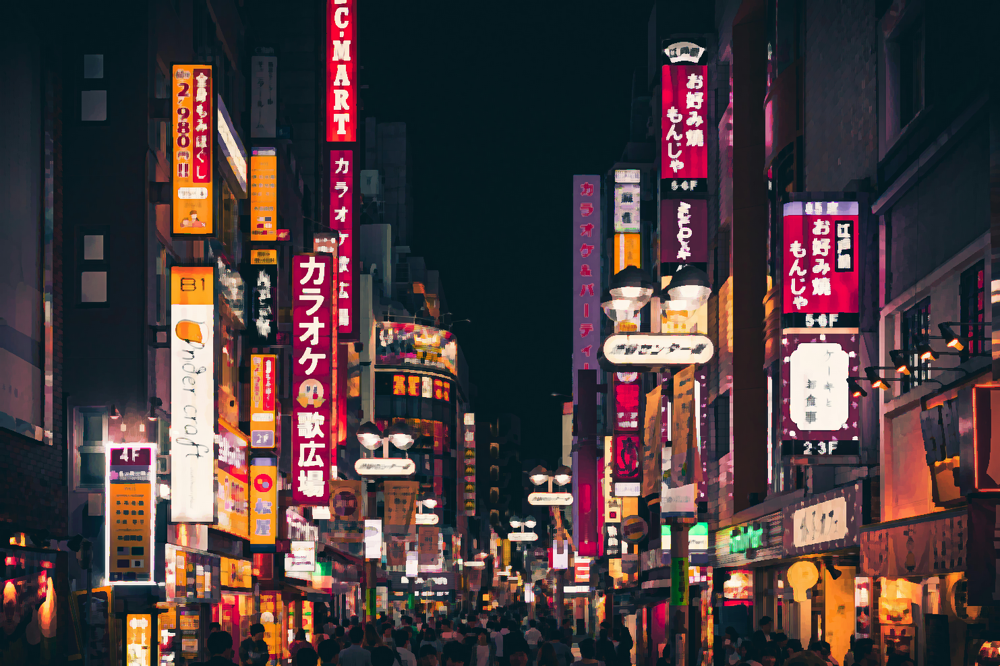

In [23]:
pil_image = Image.fromarray(imagen_filtrada_kuwahara)
display(pil_image)

# 7
**Obtén los bordes de los objetos en la imagen.**

In [88]:
img7 = cv2.imread('7.jpg')
img7_grey = cv2.cvtColor(img7, cv2.COLOR_BGR2GRAY)

He suvizado la imagen con un filtro de la mediana para que me mantenga los bordes y porque si no los otros 2 filtros funcionan bastante mal

In [89]:
# Aplicar suavizado con mediana
img7_suave = cv2.medianBlur(img7_grey, 9)


In [90]:
tamS = 3

sobelx_new = cv2.Sobel(img7_suave, cv2.CV_64F, 1, 0, ksize=tamS)
sobely_new = cv2.Sobel(img7_suave, cv2.CV_64F, 0, 1, ksize=tamS)
sobel_magnitude_new = np.sqrt(sobelx_new**2 + sobely_new**2)

In [91]:
tamL = 5
laplacian_new = cv2.Laplacian(img7_suave, cv2.CV_64F, ksize=tamL)

He escogido estos dos filtros a base de prueba y error. El que define mejor los bordes ha sido el Sobel con un kernel 3. También probé con el Detector de bordes Canny y los resultados fueron peores

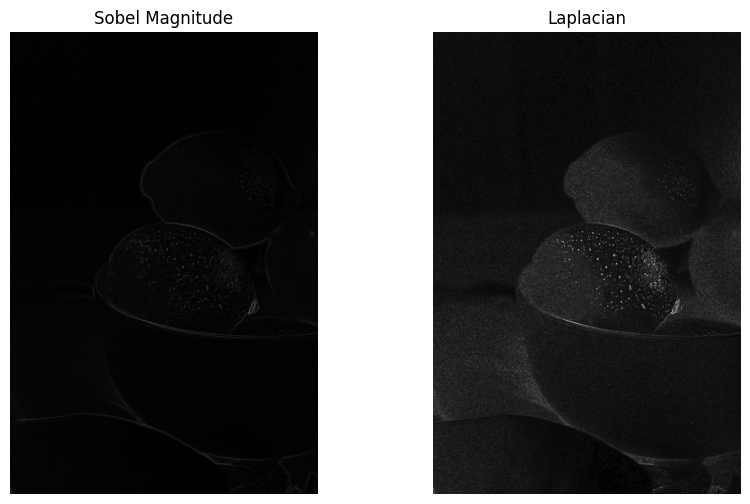

In [95]:
# Mostrar las imágenes con Sobel y Laplaciano aplicados
plt.figure(figsize=(10, 6))
plt.subplot(1, 2, 1)
plt.imshow(np.uint8(np.clip(sobel_magnitude_new, 0, 255)), cmap='gray')
plt.title('Sobel Magnitude')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(np.uint8(np.clip(np.absolute(laplacian_new), 0, 255)), cmap='gray')
plt.title('Laplacian')
plt.axis('off')

plt.show()

He ajustado el umbral y escalado el gradiente para que se aprecien mejor los bordes

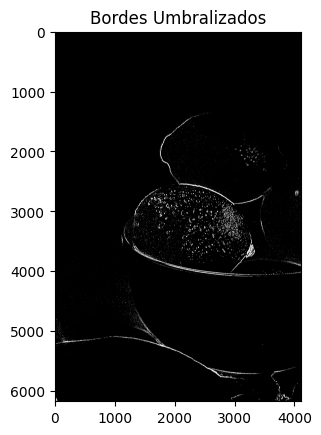

In [94]:
sobel_magnitude_scaled = cv2.convertScaleAbs(sobel_magnitude_new)

_, sobel_threshold = cv2.threshold(sobel_magnitude_scaled, 20, 255, cv2.THRESH_BINARY)
plt.imshow(sobel_threshold, cmap='gray'), plt.title('Bordes Umbralizados')
plt.show()

# 8
**Utiliza un método para detectar los objetos de la imagen**

He utilizado el Determinante de la matriz Hessiana  porque es el que menos me ha costado balancear y mejores resultados me ha dado con respecto al resto. En este ejercicio he reducido bastante la escala de la imagen para poder subir el numero de escalas sin producir un fallo de memoria. Los tamaños de los blops los he encontrado por tanteo y el 'threshold = 0.004' a 'threshold = 0.006' es el que me produce menos blops rodeando nada  y maximizando el numero de conchas rodeadas.

(507, 761, 3)


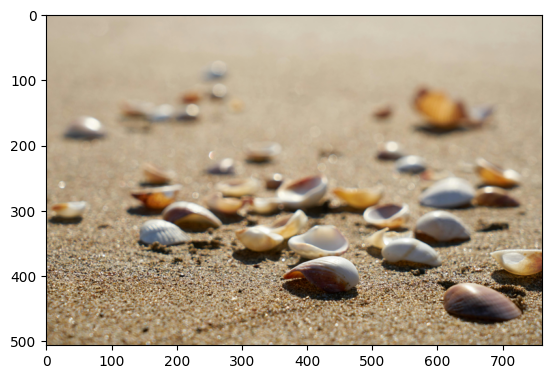

In [96]:
img8 = Image.open("8.jpg")
img8_resized = img8.resize((img8.width // 8, img8.height // 8))
imagen8_np = np.array(img8_resized)
print(imagen8_np.shape)

plt.imshow(imagen8_np)
plt.show()

Probé a suvizar la imagen preo los resultados no eran mejores

In [97]:
# suavizamos la imagen

# img8_suave = cv2.medianBlur(imagen8_np, 1)
# plt.imshow(img8_suave)
# plt.show()

## Determinante de la matriz Hessiana (DoH)

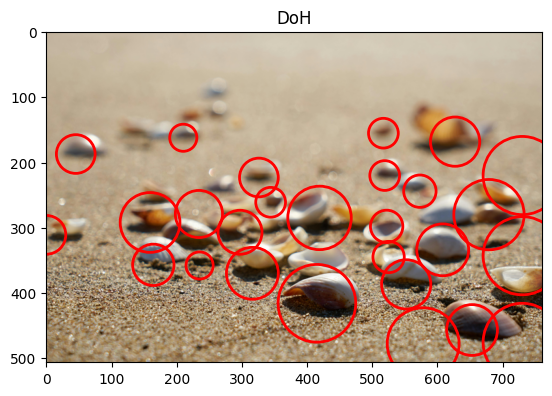

In [105]:
min_sigma = 20 # tamaño mínimo del blob
max_sigma = 60 # tamaño máximo del blob
num_sigma = 100 # Nº de escalas a considerar entre min y max
threshold = 0.004 # umbral de detección, solo se consideran puntos donde el determinante es mayor

img8_grey = cv2.cvtColor(imagen8_np, cv2.COLOR_RGB2GRAY)

# Aplica blob_log
blobs_doh = blob_doh(img8_grey, min_sigma=min_sigma, max_sigma=max_sigma, num_sigma=num_sigma, threshold=threshold)

# Muestra la imagen original con los blobs resaltados
fig, ax = plt.subplots()
ax.imshow(imagen8_np, cmap='gray')
for blob in blobs_doh:
    y, x, r = blob
    c = plt.Circle((x, y), r, color='red', linewidth=2, fill=False)
    ax.add_patch(c)

plt.title('DoH')
plt.show()

# 9 y 10
**Realiza una comparación entre las imágenes.**

(968, 648, 3)


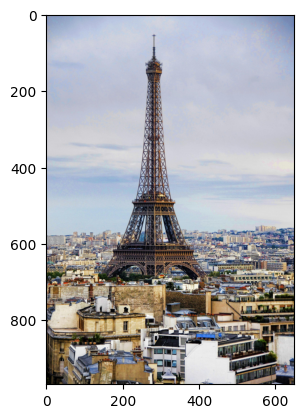

(968, 648, 3)


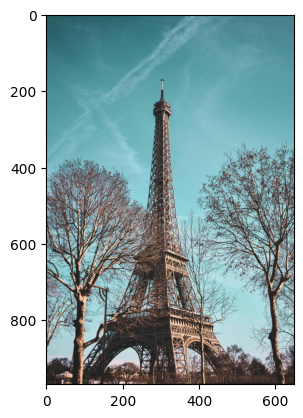

In [32]:
img9 = Image.open("9.jpg")
tam1, tam2 = img9.size
img9_resized = img9.resize((img9.width // 4, img9.height // 4))
imagen9_np = np.array(img9_resized)
print(imagen9_np.shape)

plt.imshow(imagen9_np)
plt.show()

img10 = Image.open("10.jpg")
img10_resized = img10.resize((img9.width // 4, img9.height // 4))
imagen10_np = np.array(img10_resized)
print(imagen10_np.shape)

plt.imshow(imagen10_np)
plt.show()

He seguido el ejemplo de clase, los keypoints con SIFT y los descriptores con BREIF. A SIFT no le he limitado el numero máximo de Keypoints, el numero de nOctaveLayers es 10 porque quiero que encuentre muchos keypoints y el resto de parámetros ha sido por tanteo. Tener un número alto de edgeThreshold hace que se dibujen más lineas desde los edificios.

In [106]:
sift = cv2.SIFT_create(
     # nfeatures=500,          # Máximo  keypoints
     nOctaveLayers=10,         # Capas por octava
     contrastThreshold=0.05,   # Keypoints en áreas de bajo contraste
     edgeThreshold=10,         # Filtrado de keypoints cerca de bordes
     sigma=1.4                 # Suavizado inicial
)

keypoints_sift1, descriptors_sift1 = sift.detectAndCompute(imagen9_np, None)
keypoints_sift2, descriptors_sift2 = sift.detectAndCompute(imagen10_np, None)

In [34]:
brief = cv2.xfeatures2d.BriefDescriptorExtractor_create()

keypoints_brief1, descriptors_brief1 = brief.compute(imagen9_np, keypoints_sift1)
keypoints_brief2, descriptors_brief2 = brief.compute(imagen10_np, keypoints_sift2)

In [35]:
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
matches = bf.match(descriptors_brief1, descriptors_brief2)

# Ordenar las coincidencias por distancia
matches = sorted(matches, key=lambda x: x.distance)

# Dibujar las coincidencias
img_matches = cv2.drawMatches(imagen9_np, keypoints_brief1, imagen10_np, keypoints_brief2, matches[:150], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

print(f"Número de coincidencias: {len(matches)}")

Número de coincidencias: 4523


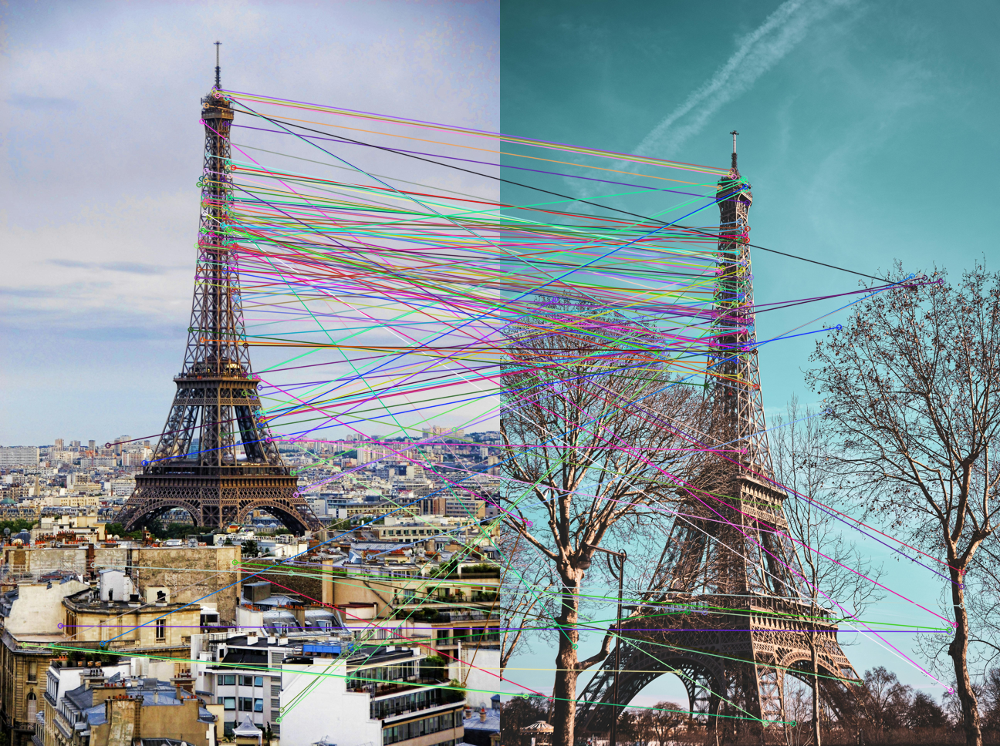

In [36]:
pil_image = Image.fromarray(img_matches)
display(pil_image)